Use virtual environment: ors_env

# <font color = 'purple'> Amenities Preprocessing

For this project, our primary criteria for optimally located apartments is the accessibility of amenities. Amenities of interest are:
- Nature & parks
- Proximity to Central Business District (this is the city center where many offices are located)
- F&B establishments
- Supermarkets
- Schools (proximity to good schools is a key consideration for parents)
- Preschools/Childcare (a key consideration for working parents)
- Train stations (trains are the main mode of transport in Singapore and hence a key consideration when apartment hunting)

In this notebook we pre-process the relevant datasets to facilitate further analysis in subsequent notebooks

In [1]:
import os
os.chdir(r"C:\Users\sharo\Documents\Postgrad\My Data Science Portfolio\Transforming the Way We Search For Flats")

In [60]:
import folium
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import requests
from tqdm import tqdm

from shapely.geometry import Point, LineString, Polygon

gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'

## <font color = 'blue'>Nature & Parks
We will merge 2 datasets:
- Man-made parks: [Masterplan 2019 Parks & Open Spaces layer](https://data.gov.sg/dataset/master-plan-2019-sdcp-park-and-open-space-layer)   
- Natural greenery/ nature reserves: [Masterplan 2019 Nature Boundary layer](https://data.gov.sg/dataset/master-plan-2019-sdcp-nature-boundary-layer)

### Parks

In [3]:
fp = "Nature & Parks/master-plan-2019-sdcp-park-and-open-space-layer.kml"
parks_os = gpd.read_file(fp, driver="KML")
parks_os.head()

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.80170 1.43855 0.00000, 103.801..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.71771 1.34016 0.00000, 103.717..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.68967 1.34304 0.00000, 103.689..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.85497 1.37601 0.00000, 103.854..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.85049 1.37645 0.00000, 103.850..."


In [4]:
def parse_parks(string):
    headers = ['PRP_STATUS']
    
    output = []
    
    for header in headers:
        start = "<th>" + header + "</th> <td>"
        end = "</td>"
        len_start = len(start)
        
        i_start = string.find(start)
        i_end = string.find(end,i_start+len_start)
        
        entry = string[(i_start+len_start):i_end]
        output.append(entry)
    
    return output

In [6]:
parks_os_1 = parks_os.copy()
parks_os_1['Status'] = parks_os_1['Description'].apply(lambda x: parse_parks(x)[0])

parks_os_1.drop(columns = ['Name','Description'], inplace=True)
parks_os_1.head()

,geometry,Status
0,"POLYGON Z ((103.80170 1.43855 0.00000, 103.801...",EXISTING
1,"POLYGON Z ((103.71771 1.34016 0.00000, 103.717...",EXISTING
2,"POLYGON Z ((103.68967 1.34304 0.00000, 103.689...",EXISTING
3,"POLYGON Z ((103.85497 1.37601 0.00000, 103.854...",EXISTING
4,"POLYGON Z ((103.85049 1.37645 0.00000, 103.850...",EXISTING


In [7]:
parks_os_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [10]:
parks_os_1.Status.value_counts()

EXISTING                       1099
PLANNED                         425
PLANNED INTERIM                  45
EXISTING INTERIM                 34
DMP19 PROPOSED PARK              31
PLANNED NOTIONAL                 29
DMP19 PROP NOTIONAL               6
EXISTING MARINE                   2
DMP19 PROP INTERIM NOTIONAL       1
PLANNED INTERIM MARINE            1
PLANNED INTERIM NOTIONAL          1
Name: Status, dtype: int64

In [12]:
#select only existing parks and open spaces
parks_os_2 = parks_os_1[parks_os_1['Status'].isin(['EXISTING','EXISTING INTERIM','EXISTING MARINE'])]
#create marker for park/openspace
parks_os_2['parks_os'] = True

parks_os_2.drop(columns=['Status'],inplace=True)
parks_os_2.head()

C:\Users\sharo\anaconda3\envs\ors_env\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
C:\Users\sharo\anaconda3\envs\ors_env\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,geometry,parks_os
0,"POLYGON Z ((103.80170 1.43855 0.00000, 103.801...",True
1,"POLYGON Z ((103.71771 1.34016 0.00000, 103.717...",True
2,"POLYGON Z ((103.68967 1.34304 0.00000, 103.689...",True
3,"POLYGON Z ((103.85497 1.37601 0.00000, 103.854...",True
4,"POLYGON Z ((103.85049 1.37645 0.00000, 103.850...",True


### Nature

In [8]:
fp = "Nature & Parks/master-plan-2019-sdcp-nature-boundary-layer-kml.kml"
nature = gpd.read_file(fp,driver="KML")
nature.head()

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.95355 1.38043 0.00000, 103.953..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.71043 1.44628 0.00000, 103.710..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.65312 1.36468 0.00000, 103.652..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.80586 1.27924 0.00000, 1..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.65454 1.37701 0.00000, 103.654..."


In [9]:
nature_1 = nature.copy()
nature_1['Status'] = nature_1['Description'].apply(lambda x: parse_parks(x)[0]) #same headers so use same function
nature_1.drop(columns = ['Name','Description'], inplace=True)

nature_1.head()

,geometry,Status
0,"POLYGON Z ((103.95355 1.38043 0.00000, 103.953...",EXISTING
1,"POLYGON Z ((103.71043 1.44628 0.00000, 103.710...",EXISTING OTHERS
2,"POLYGON Z ((103.65312 1.36468 0.00000, 103.652...",EXISTING
3,"MULTIPOLYGON Z (((103.80586 1.27924 0.00000, 1...",EXISTING
4,"POLYGON Z ((103.65454 1.37701 0.00000, 103.654...",EXISTING


In [13]:
nature_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [14]:
nature_1.Status.value_counts()

EXISTING           44
EXISTING OTHERS    13
WATERBODY           5
Name: Status, dtype: int64

In [16]:
#exclude waterbodies because incomplete
nature_2 = nature_1[nature_1['Status'].isin(['EXISTING','EXISTING OTHERS'])] 
#create marker for nature
nature_2['nature'] = True

nature_2.drop(columns=['Status'],inplace=True)
nature_2.head()

C:\Users\sharo\anaconda3\envs\ors_env\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
C:\Users\sharo\anaconda3\envs\ors_env\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


,geometry,nature
0,"POLYGON Z ((103.95355 1.38043 0.00000, 103.953...",True
1,"POLYGON Z ((103.71043 1.44628 0.00000, 103.710...",True
2,"POLYGON Z ((103.65312 1.36468 0.00000, 103.652...",True
3,"MULTIPOLYGON Z (((103.80586 1.27924 0.00000, 1...",True
4,"POLYGON Z ((103.65454 1.37701 0.00000, 103.654...",True


### Combined

In [27]:
#basemap
map1 = folium.Map(location=([1.3521,103.8198]),zoom_start=12)

green = lambda x: {'fillColor': 'green','color':'green'}
blue = lambda x: {'fillColor': 'blue','color':'blue'}

for _,row in parks_os_2.iterrows():
    buffer_gs = gpd.GeoSeries(row['geometry'])
    buffer_json = buffer_gs.to_json()
    folium.GeoJson(data=buffer_json,style_function=blue).add_to(map1)
    
for _,row in nature_2.iterrows():
    buffer_gs = gpd.GeoSeries(row['geometry'])
    buffer_json = buffer_gs.to_json()
    folium.GeoJson(data=buffer_json,style_function=green).add_to(map1)

In [26]:
map1

In [33]:
map1

In [29]:
#greenery is the union of these two. non-overlapping polygons will be preserved as is,
#overlapping polygons will be split into unique regions which are in either parks_os or nature or both
greenery = gpd.overlay(parks_os_2,nature_2,how='union')
greenery.head()

,parks_os,nature,geometry
0,True,True,"POLYGON Z ((103.77192 1.35826 0.00000, 103.771..."
1,True,True,"MULTIPOLYGON Z (((103.77164 1.35400 0.00000, 1..."
2,True,True,"MULTIPOLYGON Z (((103.77690 1.36139 0.00000, 1..."
3,True,True,"POLYGON Z ((103.77131 1.35341 0.00000, 103.770..."
4,True,True,"MULTIPOLYGON Z (((103.78222 1.35008 0.00000, 1..."


In [138]:
#basemap
map2 = folium.Map(location=([1.3521,103.8198]),zoom_start=12)

green = lambda x: {'fillColor': 'green','color':'green'}
blue = lambda x: {'fillColor': 'blue','color':'blue'}

for _,row in greenery.iterrows():
    buffer_gs = gpd.GeoSeries(row['geometry'])
    buffer_json = buffer_gs.to_json()
    if(row['nature']==True):
            folium.GeoJson(data=buffer_json,style_function=green).add_to(map2)
    else:
        folium.GeoJson(data=buffer_json,style_function=blue).add_to(map2)

In [139]:
map2

you can see it has worked for example by looking at pulau ubin or sungei buloh wetland reserve (compare map1 and map2)

In [34]:
#cleanup the dataframe
greenery_1 = greenery.copy()

def check_if_nature(nature_indicator):
    if (nature_indicator==True):
        return('nature')
    else:
        return('park_os')
    
greenery_1['type'] = greenery['nature'].apply(check_if_nature)

greenery_1.drop(columns=['parks_os','nature'],inplace=True)

greenery_1.head()

,geometry,type
0,"POLYGON Z ((103.77192 1.35826 0.00000, 103.771...",nature
1,"MULTIPOLYGON Z (((103.77164 1.35400 0.00000, 1...",nature
2,"MULTIPOLYGON Z (((103.77690 1.36139 0.00000, 1...",nature
3,"POLYGON Z ((103.77131 1.35341 0.00000, 103.770...",nature
4,"MULTIPOLYGON Z (((103.78222 1.35008 0.00000, 1...",nature


In [35]:
greenery_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Save as Shapefile

In [36]:
fp="Nature & Parks/greenery/greenery.shp"
print('Check Filepath To Avoid Accidental Overwrite')
confirm = input("Proceed to Save File? [Y/N]: ")
if confirm =='Y':
    greenery_1.to_file(fp)
    print('Saved!')
else:
    print('Not Saved.')

Check Filepath To Avoid Accidental Overwrite
Proceed to Save File? [Y/N]: Y
Saved!


## <font color = 'blue'> Planning Areas - Central Business District   
The location of the central business district can be extracted from [Masterplan 2019 Planning Area Boundaries](https://data.gov.sg/dataset/master-plan-2019-planning-area-boundary-no-sea)

In [37]:
fp = "Planning Areas/planning-boundary-area.kml"
plan_areas = gpd.read_file(fp,driver='KML')
plan_areas.head()

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.81740 1.29433 0.00000, 103.817..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.77445 1.39029 0.00000, 103.774..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.79766 1.34813 0.00000, 103.798..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.80578 1.41436 0.00000, 103.805..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.98693 1.39794 0.00000, 103.987..."


In [38]:
def parse_planarea(string):
    headers = ['PLN_AREA_N','REGION_N']
    
    output = []
    
    for header in headers:
        start = "<th>" + header + "</th> <td>"
        end = "</td>"
        len_start = len(start)
        
        i_start = string.find(start)
        i_end = string.find(end,i_start+len_start)
        
        entry = string[(i_start+len_start):i_end]
        output.append(entry)
    
    return output

In [39]:
plan_areas_1 = plan_areas.copy()
plan_areas_1['Plan_Area'] = plan_areas_1['Description'].apply(lambda x: parse_planarea(x)[0])
plan_areas_1['Region'] = plan_areas_1['Description'].apply(lambda x: parse_planarea(x)[1])

plan_areas_1.drop(columns = ['Name','Description'], inplace=True)
plan_areas_1.head()

,geometry,Plan_Area,Region
0,"POLYGON Z ((103.81740 1.29433 0.00000, 103.817...",BUKIT MERAH,CENTRAL REGION
1,"POLYGON Z ((103.77445 1.39029 0.00000, 103.774...",BUKIT PANJANG,WEST REGION
2,"POLYGON Z ((103.79766 1.34813 0.00000, 103.798...",BUKIT TIMAH,CENTRAL REGION
3,"POLYGON Z ((103.80578 1.41436 0.00000, 103.805...",CENTRAL WATER CATCHMENT,NORTH REGION
4,"POLYGON Z ((103.98693 1.39794 0.00000, 103.987...",CHANGI,EAST REGION


In [40]:
plan_areas_1

,geometry,Plan_Area,Region
0,"POLYGON Z ((103.81740 1.29433 0.00000, 103.817...",BUKIT MERAH,CENTRAL REGION
1,"POLYGON Z ((103.77445 1.39029 0.00000, 103.774...",BUKIT PANJANG,WEST REGION
2,"POLYGON Z ((103.79766 1.34813 0.00000, 103.798...",BUKIT TIMAH,CENTRAL REGION
3,"POLYGON Z ((103.80578 1.41436 0.00000, 103.805...",CENTRAL WATER CATCHMENT,NORTH REGION
4,"POLYGON Z ((103.98693 1.39794 0.00000, 103.987...",CHANGI,EAST REGION
5,"POLYGON Z ((103.74660 1.40541 0.00000, 103.746...",CHOA CHU KANG,WEST REGION
6,"POLYGON Z ((103.76707 1.33120 0.00000, 103.767...",CLEMENTI,WEST REGION
7,"POLYGON Z ((103.88152 1.38774 0.00000, 103.882...",HOUGANG,NORTH-EAST REGION
8,"POLYGON Z ((103.74350 1.34451 0.00000, 103.744...",JURONG EAST,WEST REGION
9,"POLYGON Z ((103.72813 1.34888 0.00000, 103.728...",JURONG WEST,WEST REGION


In [41]:
plan_areas_1[plan_areas_1['Plan_Area']=='DOWNTOWN CORE'] # this is the central business district

,geometry,Plan_Area,Region
36,"POLYGON Z ((103.86655 1.30386 0.00000, 103.866...",DOWNTOWN CORE,CENTRAL REGION


In [42]:
plan_areas_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Save to Shapefile

In [43]:
fp="Planning Areas/planning area shape file/plan_areas.shp"
print('Check Filepath To Avoid Accidental Overwrite')
confirm = input("Proceed to Save File? [Y/N]: ")
if confirm =='Y':
    plan_areas_1.to_file(fp)
    print('Saved!')
else:
    print('Not Saved.')

Check Filepath To Avoid Accidental Overwrite
Proceed to Save File? [Y/N]: Y
Saved!


## <font color = 'blue'> F&B Establishments
This dataset was consolidated by one of my teammates. No further pre-processing was required.

In [44]:
fp = "F&B Establishments/FOOD.shp"
food = gpd.read_file(fp)
food.head() # Cnt = number of F&B establishments at this location (e.g. there are multiple in a shopping mall or food court)

,Postal cod,Cnt,Lat,Long,geometry
0,18906,1,1.275805,103.849615,POINT (103.84962 1.27580)
1,18935,50,1.277526,103.852935,POINT (103.85294 1.27753)
2,18936,2,1.278032,103.852883,POINT (103.85288 1.27803)
3,18937,1,1.277337,103.852382,POINT (103.85238 1.27734)
4,18946,1,1.270045,103.857324,POINT (103.85732 1.27004)


## <font color = 'blue'> Supermarkets
[Download here](https://data.gov.sg/dataset/supermarkets)

In [45]:
fp = "Supermarkets/supermarkets-kml.kml"
sup_mkt = gpd.read_file(fp,driver="KML")
sup_mkt.head()

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.90126 1.40230 0.00000)
1,kml_2,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.87091 1.31424 0.00000)
2,kml_3,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.88637 1.37332 0.00000)
3,kml_4,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.91494 1.33296 0.00000)
4,kml_5,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.95301 1.35345 0.00000)


In [46]:
def parse_supmkt(string):
    tags = ['LIC_NAME', 'BLK_HOUSE', 'STR_NAME', 'UNIT_NO', 'POSTCODE']
    
    output = []
    
    for tag in tags:
        start = "<th>" + tag + "</th> <td>"
        end = "</td>"
        len_start = len(start)
        
        i_start = string.find(start)
        i_end = string.find(end,i_start+len_start)
        
        entry = string[(i_start+len_start):i_end]
        output.append(entry)
    
    return output

In [47]:
supmkt_1 = sup_mkt.copy()

supmkt_1['Lic_Name'] = supmkt_1['Description'].apply(lambda x: parse_supmkt(x)[0])

supmkt_1['Address'] = supmkt_1['Description'].apply(lambda x: parse_supmkt(x)[1] + " " + parse_supmkt(x)[2]
                                                  + ", #" + parse_supmkt(x)[3])

supmkt_1['Postcode'] = supmkt_1['Description'].apply(lambda x: parse_supmkt(x)[4])

supmkt_1.drop(columns=['Name','Description'],inplace=True)
supmkt_1.head()

,geometry,Lic_Name,Address,Postcode
0,POINT Z (103.90126 1.40230 0.00000),LI LI CHENG SUPERMARKET (PUNGGOL) PTE. LTD.,"273C PUNGGOL PLACE, #884",823273
1,POINT Z (103.87091 1.31424 0.00000),SHENG SIONG SUPERMARKET PTE LTD,"11 UPPER BOON KENG ROAD, #901",380011
2,POINT Z (103.88637 1.37332 0.00000),COLD STORAGE SINGAPORE (1983) PTE LTD,"683 HOUGANG AVENUE 8, #903",530683
3,POINT Z (103.91494 1.33296 0.00000),COLD STORAGE SINGAPORE (1983) PTE LTD,"631 BEDOK RESERVOIR ROAD, #954",470631
4,POINT Z (103.95301 1.35345 0.00000),YES SUPERMARKET PTE LTD,"201B TAMPINES STREET 21, #1091",522201


In [48]:
supmkt_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Save to Shapefile

In [49]:
fp="Supermarkets/supermarkets shapefile/supermarkets.shp"
print('Check Filepath To Avoid Accidental Overwrite')
confirm = input("Proceed to Save File? [Y/N]: ")
if confirm =='Y':
    supmkt_1.to_file(fp)
    print('Saved!')
else:
    print('Not Saved.')

Check Filepath To Avoid Accidental Overwrite
Proceed to Save File? [Y/N]: Y
Saved!


## <font color = 'blue'> Schools

In [50]:
fp = "Schools/general-information-of-schools.csv"
schools = pd.read_csv(fp, usecols=['school_name','address','postal_code','mainlevel_code'])
schools.head()

,school_name,address,postal_code,mainlevel_code
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY


### Geocode

In [51]:
#function to get coordinates using onemap API. include postalcode to cross check
def getcoordinates(address):
    req = requests.get('https://developers.onemap.sg/commonapi/search?searchVal='+address+'&returnGeom=Y&getAddrDetails=Y&pageNum=1')
    resultsdict = eval(req.text) #evaluate as python expression
    #keep only those with results
    if len(resultsdict['results'])>0:
        return resultsdict['results'][0]['LATITUDE'], resultsdict['results'][0]['LONGITUDE'], resultsdict['results'][0]['POSTAL'] #i believe the '[0]' returns the top entry
    else:
        pass

In [61]:
coordinateslist= []
failed_count = 0
addresslist = schools['address']
print(f"Total no. of addresses: {len(addresslist)}")
for address in tqdm(addresslist, desc="Geocoding..."):
    try: #try executing the following
        coordinates = getcoordinates(address)
        if len(coordinates)>0:
            coordinateslist.append(coordinates)
            
    except: #if you receive an error, do this          
        failed_count += 1
        print(f"No. of addresses with no coordinates (cummulative): {failed_count}")
        coordinateslist.append(None)

Total no. of addresses: 346


Geocoding...:  38%|███████████████████████▋                                      | 132/346 [2:31:14<3:48:25, 64.04s/it]

No. of addresses with no coordinates (cummulative): 1


Geocoding...:  40%|████████████████████████▉                                     | 139/346 [2:38:43<3:40:57, 64.05s/it]

No. of addresses with no coordinates (cummulative): 2


Geocoding...:  89%|████████████████████████████████████████████████████████▉       | 308/346 [5:39:13<40:34, 64.07s/it]

No. of addresses with no coordinates (cummulative): 3


Geocoding...:  91%|██████████████████████████████████████████████████████████      | 314/346 [5:45:37<34:09, 64.05s/it]

No. of addresses with no coordinates (cummulative): 4


Geocoding...:  99%|███████████████████████████████████████████████████████████████▋| 344/346 [6:17:38<02:08, 64.01s/it]

No. of addresses with no coordinates (cummulative): 5


Geocoding...: 100%|████████████████████████████████████████████████████████████████| 346/346 [6:19:46<00:00, 65.86s/it]


In [68]:
schools_1 = schools.join(pd.DataFrame(coordinateslist))
schools_1.rename(columns={0:'Latitude', 1:'Longitude', 2:'OneMap_pc'},inplace=True)

schools_1.head()

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.44254963931583,103.800213682734,738907
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.44589068910993,103.802398196596,737916
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.43315271543517,103.832942401086,768643
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.43605975368804,103.829718690077,768928
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.36058343005814,103.83302033725,579646


In [69]:
#a few entries had 'NIL' as postcode which was messing up the rest of the code. replace this with None
schools_1.loc[45,'OneMap_pc'] = None
schools_1.loc[220,'OneMap_pc'] = None
schools_1.loc[339,'OneMap_pc'] = None

In [70]:
schools_1[schools_1.OneMap_pc=='NIL']

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc


In [71]:
#crosscheck postcodes for matches
schools_1_m = schools_1[schools_1['Latitude'].notnull() & schools_1['Longitude'].notnull() & schools_1['OneMap_pc'].notnull()]
schools_1_m['OneMap_pc'] = schools_1_m['OneMap_pc'].apply(int) #same datatype as postal_code
schools_1_m['match'] = (schools_1_m['OneMap_pc']==schools_1_m['postal_code'])
schools_1_m.head()

C:\Users\sharo\AppData\Local\Temp/ipykernel_11144/3936203649.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  schools_1_m['OneMap_pc'] = schools_1_m['OneMap_pc'].apply(int) #same datatype as postal_code
C:\Users\sharo\AppData\Local\Temp/ipykernel_11144/3936203649.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  schools_1_m['match'] = (schools_1_m['OneMap_pc']==schools_1_m['postal_code'])


,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc,match
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.44254963931583,103.800213682734,738907,True
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.44589068910993,103.802398196596,737916,True
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.43315271543517,103.832942401086,768643,True
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.43605975368804,103.829718690077,768928,True
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.36058343005814,103.83302033725,579646,True


In [72]:
schools_1_m['match'].value_counts() #check whether all matched

True     332
False      6
Name: match, dtype: int64

In [77]:
#extract schools where geocoded postal code does not match original data
schools_1_m_wrong = schools_1_m[schools_1_m.match==False]
schools_1_m_wrong

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc,match
43,CANBERRA SECONDARY SCHOOL,51 SEMBAWANG DRIVE,757699,SECONDARY,1.37590405923514,103.83085805628,575918,False
164,MARSILING SECONDARY SCHOOL,12 MARSILING ROAD,739110,SECONDARY,1.44114152066662,103.782854561437,739169,False
198,NORTHOAKS PRIMARY SCHOOL,61 Sembawang Drive,757622,PRIMARY,1.37576042556154,103.831092893851,575923,False
250,SEMBAWANG SECONDARY SCHOOL,30 SEMBAWANG CRESCENT,757704,SECONDARY,1.37439097752486,103.827228183223,575844,False
272,ST. GABRIEL'S SECONDARY SCHOOL,24 SERANGOON AVENUE 1,556140,SECONDARY,1.3660829321479,103.873205253663,554339,False
320,WOODLANDS SECONDARY SCHOOL,11 MARSILING ROAD,739111,SECONDARY,1.44083649161365,103.782617320756,739277,False


In [78]:
# try to geocode these using school_name instead of address
coordinateslist_2= []
failed_count = 0
addresslist=schools_1_m_wrong['school_name']
print(f"Total no. of addresses: {len(addresslist)}")
for address in tqdm(addresslist, desc="Geocoding..."):
    try: #try executing the following
        coordinates = getcoordinates(address)
        if len(coordinates)>0:
            coordinateslist_2.append(coordinates)
            
    except: #if you receive an error, do this          
        failed_count += 1
        print(f"No. of addresses with no coordinates (cummulative): {failed_count}")
        coordinateslist_2.append(None)

Total no. of addresses: 6


Geocoding...: 100%|██████████████████████████████████████████████████████████████████████| 6/6 [06:27<00:00, 64.65s/it]


In [82]:
schools_1_m_wrong2 = schools_1_m_wrong.drop(columns=["Latitude","Longitude","OneMap_pc",'match']).reset_index(drop=True).join(pd.DataFrame(coordinateslist_2))
schools_1_m_wrong2 #visually check whether postcodes match

,school_name,address,postal_code,mainlevel_code,0,1,2
0,CANBERRA SECONDARY SCHOOL,51 SEMBAWANG DRIVE,757699,SECONDARY,1.45319086315972,103.814203583818,757699
1,MARSILING SECONDARY SCHOOL,12 MARSILING ROAD,739110,SECONDARY,1.43664424769955,103.776008090454,739110
2,NORTHOAKS PRIMARY SCHOOL,61 Sembawang Drive,757622,PRIMARY,1.45662379586093,103.813688476692,757622
3,SEMBAWANG SECONDARY SCHOOL,30 SEMBAWANG CRESCENT,757704,SECONDARY,1.44531502131387,103.816843258118,757704
4,ST. GABRIEL'S SECONDARY SCHOOL,24 SERANGOON AVENUE 1,556140,SECONDARY,1.34648798732177,103.876094163287,556140
5,WOODLANDS SECONDARY SCHOOL,11 MARSILING ROAD,739111,SECONDARY,1.43648894729939,103.800148469692,738239


In [83]:
req = requests.get('https://developers.onemap.sg/commonapi/search?searchVal='+"WOODLANDS SECONDARY SCHOOL"+'&returnGeom=Y&getAddrDetails=Y&pageNum=1')
resultsdict = eval(req.text) #evaluate as python expression
resultsdict

{'found': 2,
 'totalNumPages': 1,
 'pageNum': 1,
 'results': [{'SEARCHVAL': 'WOODLANDS RING SECONDARY SCHOOL',
   'BLK_NO': '10',
   'ROAD_NAME': 'WOODLANDS RING ROAD',
   'BUILDING': 'WOODLANDS RING SECONDARY SCHOOL',
   'ADDRESS': '10 WOODLANDS RING ROAD WOODLANDS RING SECONDARY SCHOOL SINGAPORE 738239',
   'POSTAL': '738239',
   'X': '24308.6728630271',
   'Y': '46465.1933193207',
   'LATITUDE': '1.43648894729939',
   'LONGITUDE': '103.800148469692',
   'LONGTITUDE': '103.800148469692'},
  {'SEARCHVAL': 'WOODLANDS SECONDARY SCHOOL',
   'BLK_NO': '11',
   'ROAD_NAME': 'MARSILING ROAD',
   'BUILDING': 'WOODLANDS SECONDARY SCHOOL',
   'ADDRESS': '11 MARSILING ROAD WOODLANDS SECONDARY SCHOOL SINGAPORE 739111',
   'POSTAL': '739111',
   'X': '21464.012295193',
   'Y': '46756.7632628027',
   'LATITUDE': '1.43912528141356',
   'LONGITUDE': '103.774586410437',
   'LONGTITUDE': '103.774586410437'}]}

Woodlands Secondary School was incorrectly geocoded as Woodlands Ring Secondary School. In future it may be worth writing code to select the result with the closest match in 'searchval' but for now fix this manually

In [93]:
schools_1_m_wrong2.loc[5,0] = resultsdict['results'][1]['LATITUDE']
schools_1_m_wrong2.loc[5,1] = resultsdict['results'][1]['LONGITUDE']
schools_1_m_wrong2.loc[5,2] = resultsdict['results'][1]['POSTAL']
schools_1_m_wrong2

,school_name,address,postal_code,mainlevel_code,0,1,2
0,CANBERRA SECONDARY SCHOOL,51 SEMBAWANG DRIVE,757699,SECONDARY,1.45319086315972,103.814203583818,757699
1,MARSILING SECONDARY SCHOOL,12 MARSILING ROAD,739110,SECONDARY,1.43664424769955,103.776008090454,739110
2,NORTHOAKS PRIMARY SCHOOL,61 Sembawang Drive,757622,PRIMARY,1.45662379586093,103.813688476692,757622
3,SEMBAWANG SECONDARY SCHOOL,30 SEMBAWANG CRESCENT,757704,SECONDARY,1.44531502131387,103.816843258118,757704
4,ST. GABRIEL'S SECONDARY SCHOOL,24 SERANGOON AVENUE 1,556140,SECONDARY,1.34648798732177,103.876094163287,556140
5,WOODLANDS SECONDARY SCHOOL,11 MARSILING ROAD,739111,SECONDARY,1.43912528141356,103.774586410437,739111


In [94]:
schools_1_m_wrong2.rename(columns={0:'Latitude', 1:'Longitude', 2:'OneMap_pc'},inplace=True)
schools_1_m_wrong2

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
0,CANBERRA SECONDARY SCHOOL,51 SEMBAWANG DRIVE,757699,SECONDARY,1.45319086315972,103.814203583818,757699
1,MARSILING SECONDARY SCHOOL,12 MARSILING ROAD,739110,SECONDARY,1.43664424769955,103.776008090454,739110
2,NORTHOAKS PRIMARY SCHOOL,61 Sembawang Drive,757622,PRIMARY,1.45662379586093,103.813688476692,757622
3,SEMBAWANG SECONDARY SCHOOL,30 SEMBAWANG CRESCENT,757704,SECONDARY,1.44531502131387,103.816843258118,757704
4,ST. GABRIEL'S SECONDARY SCHOOL,24 SERANGOON AVENUE 1,556140,SECONDARY,1.34648798732177,103.876094163287,556140
5,WOODLANDS SECONDARY SCHOOL,11 MARSILING ROAD,739111,SECONDARY,1.43912528141356,103.774586410437,739111


In [97]:
# extract correctly matched schools. will need this to merge final results
schools_1_m_right = schools_1_m[schools_1_m.match==True].drop(columns='match')
schools_1_m_right.head()

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.44254963931583,103.800213682734,738907
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.44589068910993,103.802398196596,737916
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.43315271543517,103.832942401086,768643
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.43605975368804,103.829718690077,768928
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.36058343005814,103.83302033725,579646


In [101]:
#list the schools with unmatched coordinates
schools_1_um = schools_1[schools_1['Latitude'].isnull() | schools_1['Longitude'].isnull() | schools_1['OneMap_pc'].isnull()].reset_index(drop=True)
schools_1_um

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
0,CANTONMENT PRIMARY SCHOOL,1 Cantonment Close,88256,PRIMARY,1.27547252623201,103.839962631748,None
1,HOUGANG PRIMARY SCHOOL,1 HOUGANG ST 93,534238,PRIMARY,None,None,None
2,JING SHAN PRIMARY SCHOOL,5 ANG MO KIO ST 52,569228,PRIMARY,None,None,None
3,PIONEER PRIMARY SCHOOL,23 JURONG WEST STREET 81,649076,PRIMARY,1.34872092746567,103.694867873154,None
4,WEST GROVE PRIMARY SCHOOL,1 JURONG WEST ST 72,649223,PRIMARY,None,None,None
5,WHITE SANDS PRIMARY SCHOOL,2 PASIR RIS ST 11,519075,PRIMARY,None,None,None
6,YUSOF ISHAK SECONDARY SCHOOL,11 BUKIT BATOK STREET 25,658712,SECONDARY,1.34233377803496,103.760013141667,None
7,ZHENGHUA SECONDARY SCHOOL,91 SENJA ROAD,677741,SECONDARY,None,None,None


In [102]:
#try matching using school name
coordinateslist_3= []
failed_count = 0
addresslist=schools_1_um['school_name']
print(f"Total no. of addresses: {len(addresslist)}")
for address in tqdm(addresslist, desc="Geocoding..."):
    try: #try executing the following
        coordinates = getcoordinates(address)
        if len(coordinates)>0:
            coordinateslist_3.append(coordinates)
            
    except: #if you receive an error, do this          
        failed_count += 1
        print(f"No. of addresses with no coordinates (cummulative): {failed_count}")
        coordinateslist_3.append(None)

Total no. of addresses: 8


Geocoding...: 100%|██████████████████████████████████████████████████████████████████████| 8/8 [08:36<00:00, 64.61s/it]


In [110]:
schools_1_um_1 = schools_1_um.drop(columns=["Latitude","Longitude","OneMap_pc"]).join(pd.DataFrame(coordinateslist_3))
schools_1_um_1.rename(columns={0:'Latitude', 1:'Longitude', 2:'OneMap_pc'},inplace=True)
schools_1_um_1.OneMap_pc = schools_1_um_1.OneMap_pc.apply(int)

schools_1_um_1 #visually checked whether postcodes match

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
0,CANTONMENT PRIMARY SCHOOL,1 Cantonment Close,88256,PRIMARY,1.27547252623201,103.839962631748,88256
1,HOUGANG PRIMARY SCHOOL,1 HOUGANG ST 93,534238,PRIMARY,1.37738245231461,103.880805274557,534238
2,JING SHAN PRIMARY SCHOOL,5 ANG MO KIO ST 52,569228,PRIMARY,1.37223290983498,103.852132214306,569228
3,PIONEER PRIMARY SCHOOL,23 JURONG WEST STREET 81,649076,PRIMARY,1.33902264667589,103.687769623983,649037
4,WEST GROVE PRIMARY SCHOOL,1 JURONG WEST ST 72,649223,PRIMARY,1.3448790560014,103.699286360581,649223
5,WHITE SANDS PRIMARY SCHOOL,2 PASIR RIS ST 11,519075,PRIMARY,1.36563610941695,103.960861814678,519075
6,YUSOF ISHAK SECONDARY SCHOOL,11 BUKIT BATOK STREET 25,658712,SECONDARY,1.40693702458178,103.896275149571,828676
7,ZHENGHUA SECONDARY SCHOOL,91 SENJA ROAD,677741,SECONDARY,1.38836583415352,103.765510638527,679962


In [111]:
schools_1_um_1[schools_1_um_1.postal_code != schools_1_um_1.OneMap_pc]

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,OneMap_pc
3,PIONEER PRIMARY SCHOOL,23 JURONG WEST STREET 81,649076,PRIMARY,1.33902264667589,103.687769623983,649037
6,YUSOF ISHAK SECONDARY SCHOOL,11 BUKIT BATOK STREET 25,658712,SECONDARY,1.40693702458178,103.896275149571,828676
7,ZHENGHUA SECONDARY SCHOOL,91 SENJA ROAD,677741,SECONDARY,1.38836583415352,103.765510638527,679962


Checked OneMap and Google Maps and verified that OneMap results are actually correct. These schools probably relocated recently and their addresses in our schools dataset were not updated.

In [112]:
#piece together 
#   schools_1_m_right : successful and correct (pc match) geocoding using address
#   schools_1_m_wrong2 : successful but wrong geocoding using address. Fixed using school name
#   schools_1_um_1 : unsuccessful geocoding using address. Fixed using school name
#then drop the OneMap_pc column

schools_2 = pd.concat([schools_1_m_right, schools_1_m_wrong2, schools_1_um_1]).drop(columns=['OneMap_pc'])
schools_2.head()

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.44254963931583,103.800213682734
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.44589068910993,103.802398196596
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.43315271543517,103.832942401086
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.43605975368804,103.829718690077
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.36058343005814,103.83302033725


In [114]:
#long and lat should be floats, not strings
schools_2['Latitude'] = schools_2['Latitude'].apply(float)
schools_2['Longitude'] = schools_2['Longitude'].apply(float)
schools_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 346 entries, 0 to 7
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   school_name     346 non-null    object 
 1   address         346 non-null    object 
 2   postal_code     346 non-null    int64  
 3   mainlevel_code  346 non-null    object 
 4   Latitude        346 non-null    float64
 5   Longitude       346 non-null    float64
dtypes: float64(2), int64(1), object(3)
memory usage: 18.9+ KB


### Convert to Shapefile

In [115]:
#convert long and lat to shapely point
schools_3 = schools_2.copy()
schools_3['geometry'] = schools_3.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)

#convert to geodataframe
schools_3 = gpd.GeoDataFrame(schools_3,crs="EPSG:4326")
type(schools_3)

geopandas.geodataframe.GeoDataFrame

In [116]:
schools_3.head()

,school_name,address,postal_code,mainlevel_code,Latitude,Longitude,geometry
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.442550,103.800214,POINT (103.80021 1.44255)
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.445891,103.802398,POINT (103.80240 1.44589)
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.433153,103.832942,POINT (103.83294 1.43315)
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.436060,103.829719,POINT (103.82972 1.43606)
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.360583,103.833020,POINT (103.83302 1.36058)


In [117]:
schools_3.rename(columns={'school_name':'name','mainlevel_code':'main_lvl','postal_code':'postcode'},inplace=True)
schools_3.head()

,name,address,postcode,main_lvl,Latitude,Longitude,geometry
0,ADMIRALTY PRIMARY SCHOOL,11 WOODLANDS CIRCLE,738907,PRIMARY,1.442550,103.800214,POINT (103.80021 1.44255)
1,ADMIRALTY SECONDARY SCHOOL,31 WOODLANDS CRESCENT,737916,SECONDARY,1.445891,103.802398,POINT (103.80240 1.44589)
2,AHMAD IBRAHIM PRIMARY SCHOOL,10 YISHUN STREET 11,768643,PRIMARY,1.433153,103.832942,POINT (103.83294 1.43315)
3,AHMAD IBRAHIM SECONDARY SCHOOL,751 YISHUN AVENUE 7,768928,SECONDARY,1.436060,103.829719,POINT (103.82972 1.43606)
4,AI TONG SCHOOL,100 Bright Hill Drive,579646,PRIMARY,1.360583,103.833020,POINT (103.83302 1.36058)


### Save to Shapefile

In [118]:
fp="Schools/schools shapefile/schools.shp"
print('Check Filepath To Avoid Accidental Overwrite')
confirm = input("Proceed to Save File? [Y/N]: ")
if confirm =='Y':
    schools_3.to_file(fp)
    print('Saved!')
else:
    print('Not Saved.')

Check Filepath To Avoid Accidental Overwrite
Proceed to Save File? [Y/N]: Y
Saved!


## <font color = 'blue'> Preschools
The dataset used here was originally downloaded as a kml file from data.gov.sg but seems to be no longer available.   
[What is currently available](https://data.gov.sg/dataset/listing-of-centres) is a csv file and will require geocoding.

In [53]:
fp = "Preschools/pre-schools-location-kml.kml"
presch = gpd.read_file(fp,driver="KML")
presch.head()

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.70086 1.33832 0.00000)
1,kml_2,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.89866 1.39044 0.00000)
2,kml_3,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.80681 1.43802 0.00000)
3,kml_4,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.78742 1.43344 0.00000)
4,kml_5,<center><table><tr><th colspan='2' align='cent...,POINT Z (103.88863 1.39565 0.00000)


In [54]:
def parse_presch(string):
    headers = ['CENTRE_NAME','ADDRESS','POSTAL_CODE']
    
    output = []
    
    for header in headers:
        start = "<th>" + header + "</th> <td>"
        end = "</td>"
        len_start = len(start)
        
        i_start = string.find(start)
        i_end = string.find(end,i_start+len_start)
        
        entry = string[(i_start+len_start):i_end]
        output.append(entry)
    
    return output

In [55]:
presch_1 = presch.drop(columns=['Name'])

presch_1['Name'] = presch_1['Description'].apply(lambda x: parse_presch(x)[0])
presch_1['Address'] = presch_1['Description'].apply(lambda x: parse_presch(x)[1])
presch_1['Postcode'] = presch_1['Description'].apply(lambda x: parse_presch(x)[2])

presch_1.drop(columns=['Description'],inplace=True)
presch_1.head()

,geometry,Name,Address,Postcode
0,POINT Z (103.70086 1.33832 0.00000),BRILLIANT TOTS PTE. LTD.,"610, JURONG WEST STREET 65, #01 - 534, S 640610",640610
1,POINT Z (103.89866 1.39044 0.00000),BUBBLESLAND PLAYHOUSE PTE LTD,"238, COMPASSVALE WALK, #01 - 542, S 540238",540238
2,POINT Z (103.80681 1.43802 0.00000),BUCKET HOUSE PRESCHOOL,"39, WOODLANDS CLOSE, #01 - 62, MEGA@WOODLANDS,...",737856
3,POINT Z (103.78742 1.43344 0.00000),BUMBLE BEE CHILD CARE CENTRE,"369, WOODLANDS AVENUE 1, #01 - 853, S 730369",730369
4,POINT Z (103.88863 1.39565 0.00000),BUSY BEES SINGAPORE PTE LTD,"327B, ANCHORVALE ROAD, #01 - 322, S 542327",542327


In [56]:
presch_1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Save to Shapefile

In [57]:
fp="Preschools/preschools shapefile/preschools.shp"
print('Check Filepath To Avoid Accidental Overwrite')
confirm = input("Proceed to Save File? [Y/N]: ")
if confirm =='Y':
    presch_1.to_file(fp)
    print('Saved!')
else:
    print('Not Saved.')

Check Filepath To Avoid Accidental Overwrite
Proceed to Save File? [Y/N]: Y
Saved!


## Train Stations
Search for 'Train Station' dataset [here](https://datamall.lta.gov.sg/content/datamall/en/static-data.html)   
This dataset came as a shapefile. No further pre-processing was needed

In [58]:
fp = "MRT Station/MRTLRTStnPtt.shp"
mrt = gpd.read_file(fp)
mrt.head()

,OBJECTID,STN_NAME,STN_NO,geometry
0,1,EUNOS MRT STATION,EW7,POINT (35782.955 33560.078)
1,2,CHINESE GARDEN MRT STATION,EW25,POINT (16790.747 36056.302)
2,3,KHATIB MRT STATION,NS14,POINT (27962.311 44352.568)
3,4,KRANJI MRT STATION,NS7,POINT (20081.697 45214.548)
4,5,REDHILL MRT STATION,EW18,POINT (26163.478 30218.820)


Visualisation Using Geopandas

<AxesSubplot:>

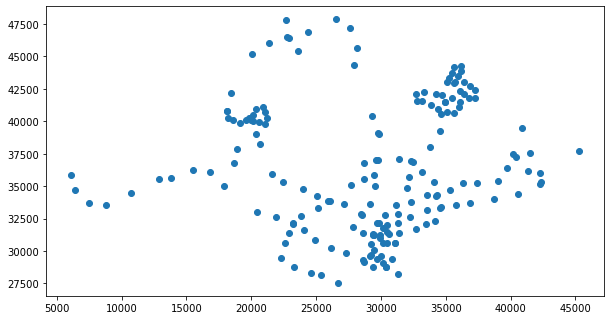

In [121]:
import matplotlib.pyplot as plt
import geopandas as gpd

fig, ax = plt.subplots(figsize=(10,7))
mrt.plot(ax=ax)

Visualisation Using Folium

In [128]:
# create basemap
map1 = folium.Map(location=([1.3521,103.8198]), # [latitude, longitude]
                  zoom_start = 11.5) #initial zoom level
map1

In [129]:
mrt = mrt.to_crs('EPSG:4326') #reproject for compatibility with folium
mrt.head()

,OBJECTID,STN_NAME,STN_NO,geometry
0,1,EUNOS MRT STATION,EW7,POINT (103.90325 1.31978)
1,2,CHINESE GARDEN MRT STATION,EW25,POINT (103.73260 1.34235)
2,3,KHATIB MRT STATION,NS14,POINT (103.83298 1.41738)
3,4,KRANJI MRT STATION,NS7,POINT (103.76217 1.42518)
4,5,REDHILL MRT STATION,EW18,POINT (103.81682 1.28956)


In [134]:
for _,row in mrt.iterrows(): 
    row['location'] = list(reversed((row['geometry'].x,row['geometry'].y))) # folium requires location as [latitude, longitude]
    folium.map.Marker(location=row['location'],               # marker location
                     icon=folium.Icon(color='red',            # custom marker style
                                     icon_color='black',
                                     icon='train',
                                     prefix='fa'),
                     popup=row['STN_NAME']).add_to(map1)      #info to display when marker is clicked on
map1